                       Name Platform  Year_of_Release         Genre Publisher  \
0                Wii Sports      Wii           2006.0        Sports  Nintendo   
1         Super Mario Bros.      NES           1985.0      Platform  Nintendo   
2            Mario Kart Wii      Wii           2008.0        Racing  Nintendo   
3         Wii Sports Resort      Wii           2009.0        Sports  Nintendo   
4  Pokemon Red/Pokemon Blue       GB           1996.0  Role-Playing  Nintendo   

   NA_Sales  EU_Sales  JP_Sales  Other_Sales  Global_Sales  Critic_Score  \
0     41.36     28.96      3.77         8.45         82.53          76.0   
1     29.08      3.58      6.81         0.77         40.24           NaN   
2     15.68     12.76      3.79         3.29         35.52          82.0   
3     15.61     10.93      3.28         2.95         32.77          80.0   
4     11.27      8.89     10.22         1.00         31.37           NaN   

   Critic_Count User_Score  User_Count Developer Rating 

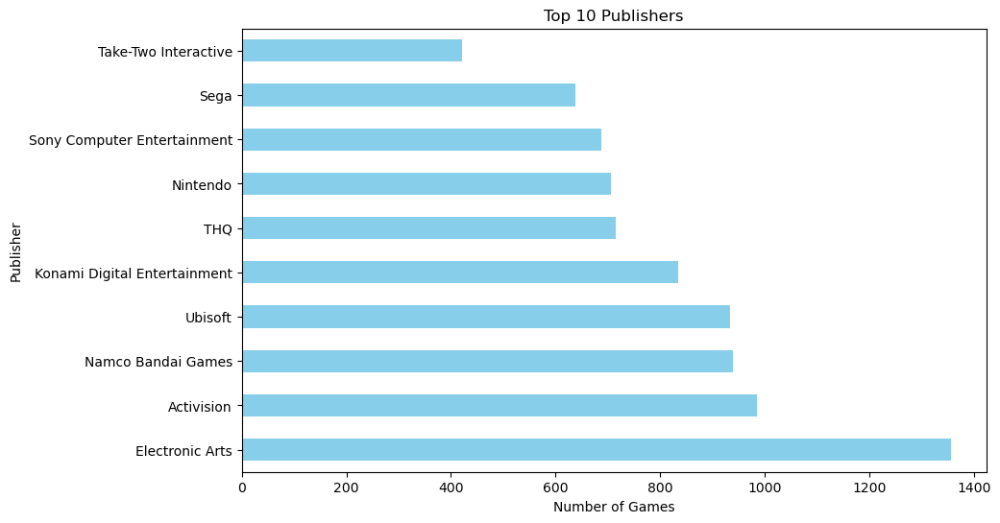

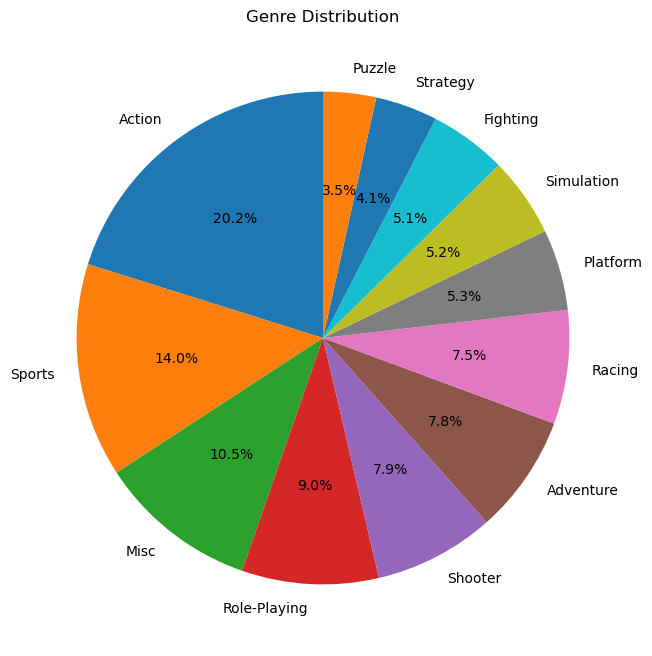

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the dataset
df = pd.read_csv("Video_Games.csv")

# Display the first few rows of the dataset
print(df.head())

# Example 1: Bar chart - Top publishers
top_publishers = df['Publisher'].value_counts().nlargest(10)
plt.figure(figsize=(10, 6))
top_publishers.plot(kind='barh', color='skyblue')
plt.title('Top 10 Publishers')
plt.xlabel('Number of Games')
plt.ylabel('Publisher')
plt.show()



# Example 3: Pie chart - Genre distribution
genre_distribution = df['Genre'].value_counts()
plt.figure(figsize=(8, 8))
plt.pie(genre_distribution, labels=genre_distribution.index, autopct='%1.1f%%', startangle=90)
plt.title('Genre Distribution')
plt.show()


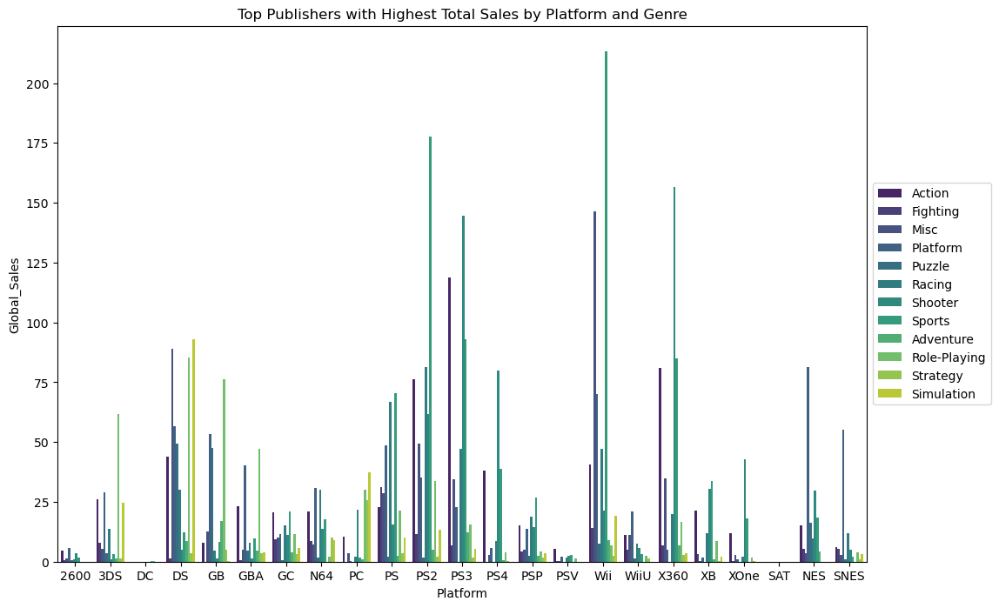

In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


df = pd.read_csv("Video_Games.csv")


publisher_platform_genre_sales = df.groupby(['Publisher', 'Platform', 'Genre'], as_index=False)['Global_Sales'].sum()


top_publishers = publisher_platform_genre_sales.groupby('Publisher')['Global_Sales'].sum().nlargest(5).index
filtered_data = publisher_platform_genre_sales[publisher_platform_genre_sales['Publisher'].isin(top_publishers)]


plt.figure(figsize=(12, 8))
ax = sns.barplot(
    x='Platform', y='Global_Sales', hue='Genre', data=filtered_data,
    ci=None, palette='viridis', estimator=sum
)


ax.legend(loc='center left', bbox_to_anchor=(1, 0.5))

plt.title('Top Publishers with Highest Total Sales by Platform and Genre')
plt.show()


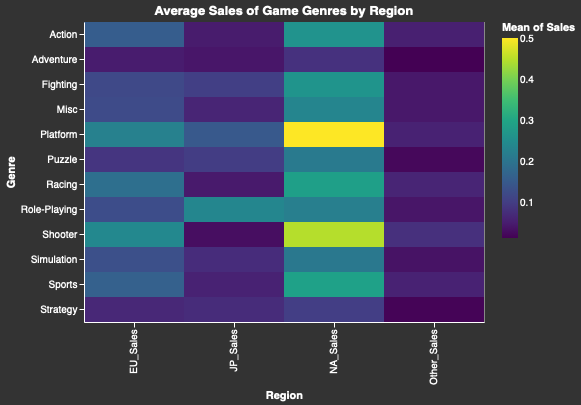

In [37]:
import pandas as pd
import altair as alt
from IPython.display import display


df = pd.read_csv("Video_Games.csv")


sales_columns = ['JP_Sales', 'NA_Sales', 'EU_Sales', 'Other_Sales']
subset_df = df[['Genre'] + sales_columns]


subset_df = subset_df.dropna()


melted_df = pd.melt(subset_df, id_vars=['Genre'], value_vars=sales_columns, var_name='Region', value_name='Sales')


alt_heatmap = alt.Chart(melted_df).mark_rect().encode(
    x='Region:N',
    y='Genre:N',
    color=alt.Color('mean(Sales):Q', scale=alt.Scale(scheme='viridis')),
    tooltip=['Region:N', 'Genre:N', alt.Tooltip('mean(Sales):Q', title='Average Sales')]
).properties(
    title='Average Sales of Game Genres by Region ',
    width=400,
    height=300
)


display(alt_heatmap)


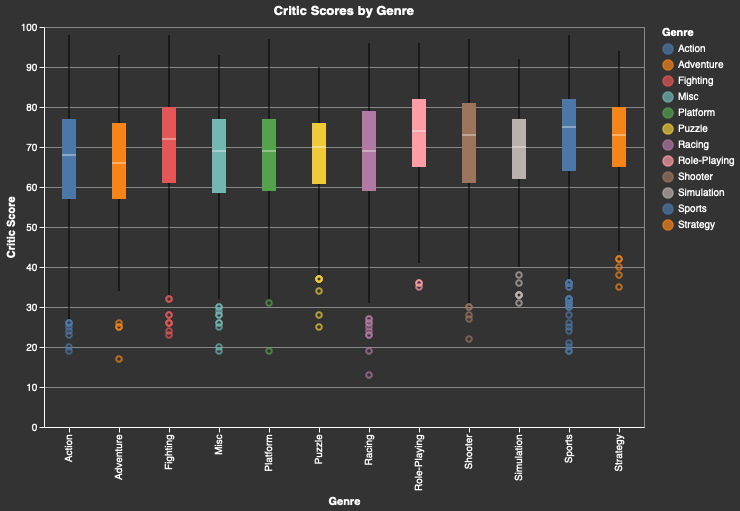

In [36]:
import pandas as pd
import altair as alt


alt.renderers.enable('mimetype')


df = pd.read_csv("Video_Games.csv")


alt_boxplot = alt.Chart(df).mark_boxplot().encode(
    x=alt.X('Genre:N', title='Genre'),
    y=alt.Y('Critic_Score:Q', title='Critic Score'),
    color=alt.Color('Genre:N', title='Genre'),
    tooltip=['Genre:N', 'Critic_Score:Q']
).properties(
    width=600,
    height=400,
    title='Critic Scores by Genre '
).interactive()

alt_boxplot



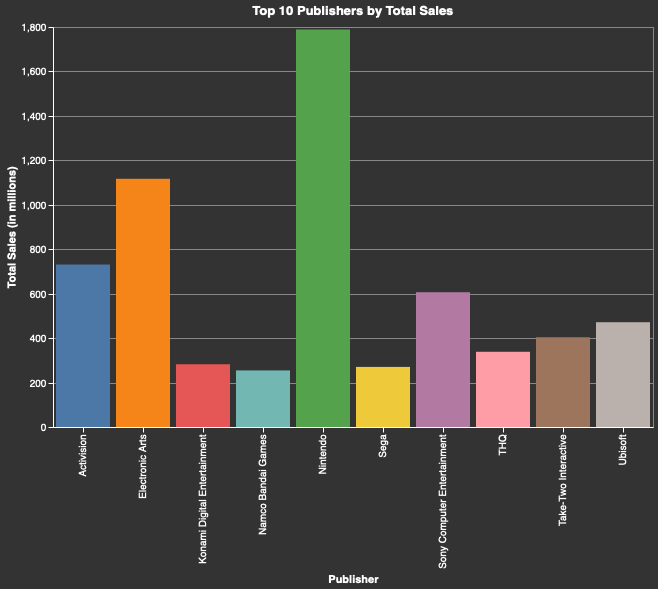

In [41]:
import pandas as pd
import altair as alt
from IPython.display import display


df = pd.read_csv("Video_Games.csv")


publisher_sales = df.groupby('Publisher')['Global_Sales'].sum().reset_index()


publisher_sales = publisher_sales.sort_values(by='Global_Sales', ascending=False)


bar_chart = alt.Chart(publisher_sales.head(10)).mark_bar().encode(
    x=alt.X('Publisher:N', title='Publisher'),
    y=alt.Y('Global_Sales:Q', title='Total Sales (in millions)'),
    color=alt.Color('Publisher:N', legend=None),
    tooltip=['Publisher:N', 'Global_Sales:Q']
).properties(
    title='Top 10 Publishers by Total Sales',
    width=600,
    height=400
)


display(bar_chart)


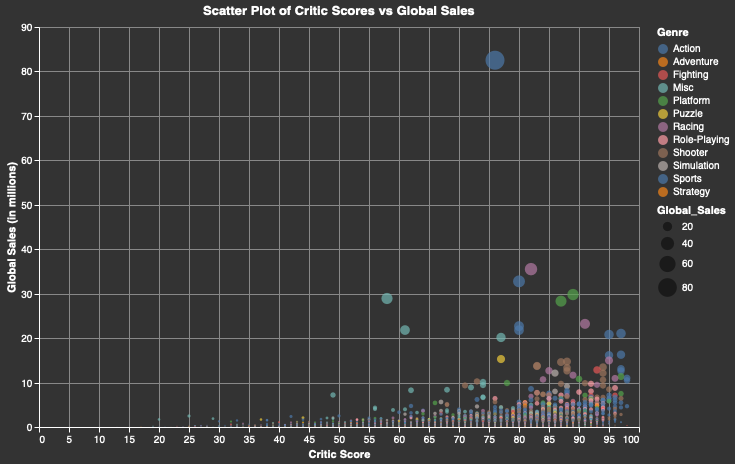

In [42]:
import pandas as pd
import altair as alt
from IPython.display import display


df = pd.read_csv("Video_Games.csv")


df_cleaned = df.dropna(subset=['Critic_Score', 'Global_Sales'])


scatter_plot = alt.Chart(df_cleaned).mark_circle().encode(
    x=alt.X('Critic_Score:Q', title='Critic Score'),
    y=alt.Y('Global_Sales:Q', title='Global Sales (in millions)'),
    color=alt.Color('Genre:N', title='Genre'),
    size='Global_Sales:Q',
    tooltip=['Name:N', 'Critic_Score:Q', 'Global_Sales:Q']
).properties(
    title='Scatter Plot of Critic Scores vs Global Sales',
    width=600,
    height=400
)


display(scatter_plot)


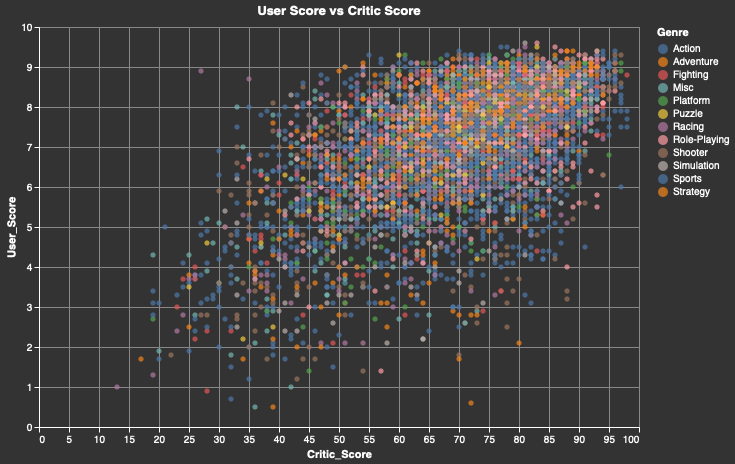

In [68]:
import pandas as pd
import altair as alt


df = pd.read_csv("Video_Games.csv")


df_cleaned = df.dropna(subset=['User_Score', 'Critic_Score'])


scatter_plot = alt.Chart(df_cleaned).mark_circle().encode(
    x='Critic_Score:Q',
    y='User_Score:Q',
    color='Genre:N',
    tooltip=['Name:N', 'Critic_Score:Q', 'User_Score:Q', 'Genre:N']
).properties(
    title='User Score vs Critic Score',
    width=600,
    height=400
)


scatter_plot


In [13]:
import pandas as pd
import altair as alt


df = pd.read_csv("Video_Games.csv")


df_filtered = df.dropna(subset=['Developer', 'NA_Sales', 'JP_Sales'])


developer_sales = df_filtered.groupby('Developer')[['NA_Sales', 'JP_Sales']].sum().reset_index()


top_na_developers = developer_sales.nlargest(10, 'NA_Sales')


top_jp_developers = developer_sales.nlargest(10, 'JP_Sales')


chart_na_sales = alt.Chart(top_na_developers).mark_bar().encode(
    x=alt.X('NA_Sales:Q', title='NA Sales (in millions)'),
    y=alt.Y('Developer:N', title='Developer', sort='-x'),
    color=alt.Color('Developer:N', legend=None),
    tooltip=['Developer:N', 'NA_Sales:Q']
).properties(
    title='Top 10 Developers by NA Sales',
    width=400,
    height=300
)

chart_jp_sales = alt.Chart(top_jp_developers).mark_bar().encode(
    x=alt.X('JP_Sales:Q', title='JP Sales (in millions)'),
    y=alt.Y('Developer:N', title='Developer', sort='-x'),
    color=alt.Color('Developer:N', legend=None),
    tooltip=['Developer:N', 'JP_Sales:Q']
).properties(
    title='Top 10 Developers by JP Sales',
    width=400,
    height=300
)


(chart_na_sales | chart_jp_sales).configure_axis(labelFontSize=12, titleFontSize=14).configure_legend(titleFontSize=12, labelFontSize=10)


alt.HConcatChart(...)

In [19]:
import pandas as pd
import altair as alt


df = pd.read_csv("Video_Games.csv")


df_filtered = df[(df['Year_of_Release'] >= 1992) & (df['Year_of_Release'] <= 2020)]


publisher_sales = df_filtered.groupby(['Publisher', 'Year_of_Release'])['Global_Sales'].sum().reset_index()


top_publishers = publisher_sales.groupby('Publisher')['Global_Sales'].sum().nlargest(10).index


top_publishers_data = publisher_sales[publisher_sales['Publisher'].isin(top_publishers)]


line_chart = alt.Chart(top_publishers_data).mark_line().encode(
    x=alt.X('Year_of_Release:N', title='Year of Release', axis=alt.Axis(labelAngle=-45)),
    y=alt.Y('Global_Sales:Q', title='Global Sales (in millions)'),
    color=alt.Color('Publisher:N', title='Publisher'),
    tooltip=['Publisher:N', 'Year_of_Release:N', 'Global_Sales:Q']
).properties(
    title='Top 10 Publishers (1992-2020) by Global Sales - Line Chart',
    width=800,
    height=500
).interactive()


line_chart.configure_axis(labelFontSize=12, titleFontSize=14).configure_legend(titleFontSize=12, labelFontSize=10)


alt.Chart(...)

In [3]:
import pandas as pd
import altair as alt
from IPython.display import display


alt.data_transformers.enable('vegafusion')

df = pd.read_csv("Video_Games.csv")

sales_columns = ['JP_Sales', 'NA_Sales', 'EU_Sales', 'Other_Sales']
subset_df = df[['Genre'] + sales_columns]

subset_df = subset_df.dropna()

melted_df = pd.melt(subset_df, id_vars=['Genre'], value_vars=sales_columns, var_name='Region', value_name='Sales')

stacked_bar_chart = alt.Chart(melted_df).mark_bar().encode(
    x='Genre:N',
    y='sum(Sales):Q',
    color='Region:N',
    tooltip=['Genre:N', 'Region:N', alt.Tooltip('sum(Sales):Q', title='Total Sales')]
).properties(
    title='Total Sales of Game Genres by Region ',
    width=600,
    height=400
)

display(stacked_bar_chart)


alt.Chart(...)